In [1]:
import torch
print("CUDA Available: ", torch.cuda.is_available())
print("Number of GPUs: ", torch.cuda.device_count())

CUDA Available:  True
Number of GPUs:  4


In [18]:
import scanpy as sc
print(sc.__version__)


1.11.4


In [19]:
import sys
import os
import anndata
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns

In [20]:
import torch
import torch.distributed as dist
from torch.nn.parallel import DistributedDataParallel as DDP

In [ ]:
adata = sc.read_h5ad('/work/home/cryoem666/xyf/temp/pycharm/Squidiff/data/adata_norm.h5ad')

In [22]:
adata_ctl = adata[adata.obs['group'] == 'Control'].copy()

In [23]:
sc.tl.pca(adata_ctl, svd_solver='arpack')
sc.pp.neighbors(adata_ctl, n_neighbors=30, n_pcs=50)
sc.tl.umap(adata_ctl,min_dist=0.8)

In [24]:
adata_ctl = adata_ctl[adata_ctl.obs['Major_type']!='HSC-like']

EC1
EC2
EC3
EC4
EC5
EC6
Fibroblast1
Fibroblast2
Fibroblast3
Fibroblast4
Fibroblast5
Fibroblast6
Fibroblast7
Mural1
Mural2
Mural3
Mural4
Mural5
Mural6
Mural7
Mural8
Mural9


(np.float64(-9.946371507644653),
 np.float64(11.259953927993774),
 np.float64(10.848247003555297),
 np.float64(30.85770182609558))

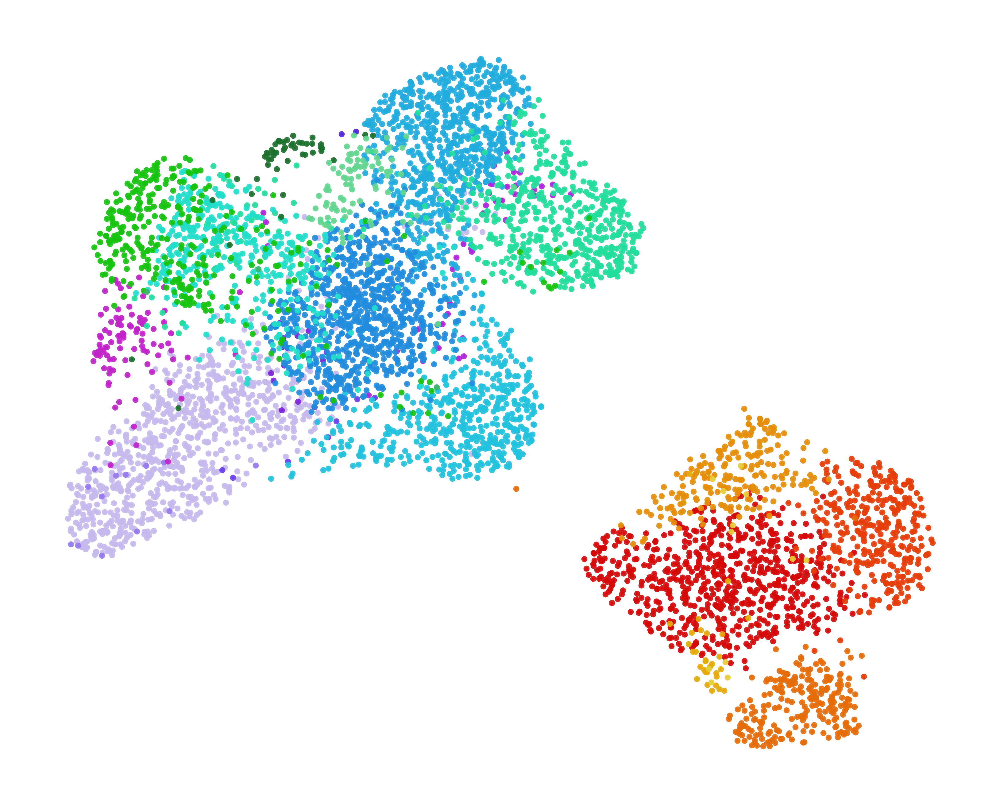

In [25]:
### Define your hexadecimal color codes
import matplotlib.colors as mcolors
hex_colors  = ['#d60909', # EC1
               '#e63d09', # EC2
               '#e66c09', # EC3
               '#e68e09', # EC4
               '#e6ab09', # EC5
               '#e6ce37', # EC6
               '#c6b9ed', # Fibroblast1, 
               '#9678f0', # Fibroblast2, 
               '#6a3eed', # Fibroblast3, 
               '#5021de', # Fibroblast4,
               '#8021de', # Fibroblast5, 
               '#af21de', # Fibroblast6, 
               '#c122c9', # Fibroblast7, 
               #'#e34f4f', # HSC
               '#21c2de', # Mural1 
               '#21acde', # Mural2
               '#218cde', # Mural3
               '#21de9c', # Mural4
               '#21decb', # Mural5
               '#16c410', # Mural6 
               '#3cb56c', # Mural7
               '#1c702d', # Mural8
               '#63d690' # Mural9 
              ]
# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(5,4),dpi=800)
for (j,i) in enumerate(np.unique(adata_ctl.obs['Minor_type'])):
    print(i)
    g=axs.scatter(adata_ctl.obsm['X_umap'][adata_ctl.obs['Minor_type']==i, 0], 
                  adata_ctl.obsm['X_umap'][adata_ctl.obs['Minor_type']==i, 1], 
                  color=hex_colors[j], 
                  alpha=0.9,s=0.6, 
                 )
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [26]:
adata_ctl

View of AnnData object with n_obs × n_vars = 5838 × 26820
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_diffmap', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

(np.float64(-9.946371507644653),
 np.float64(11.259953927993774),
 np.float64(10.848247003555297),
 np.float64(30.85770182609558))

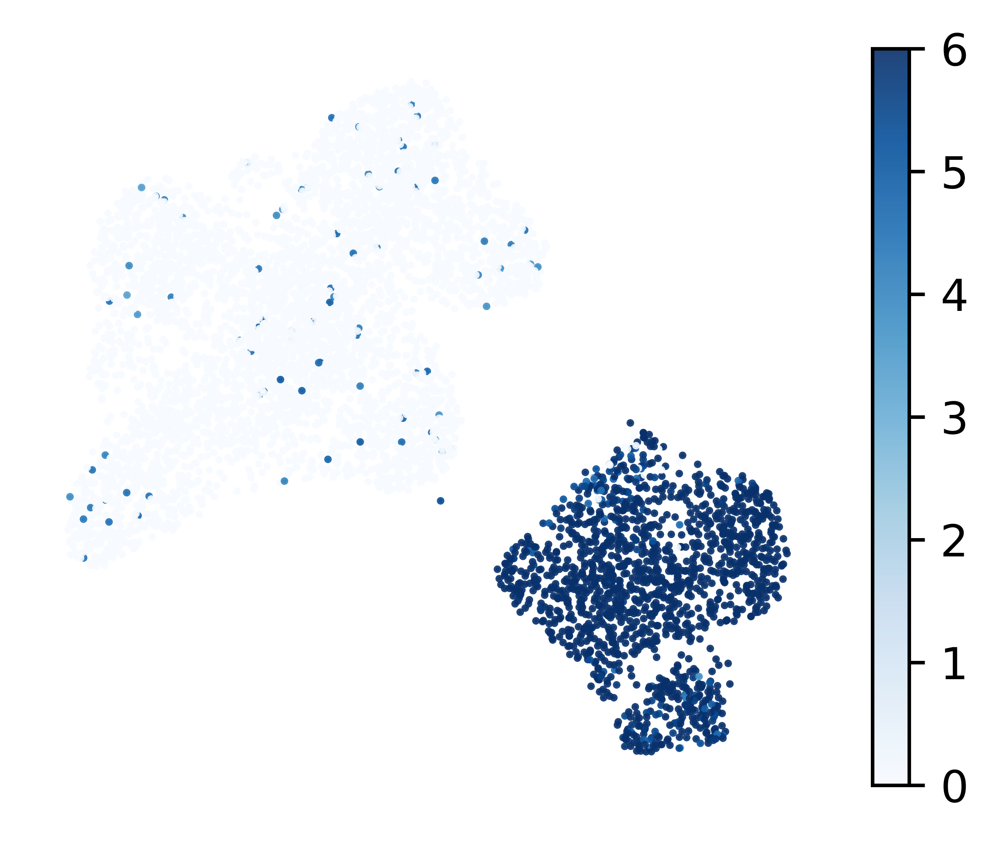

In [27]:
fig, axs = plt.subplots(1,1,figsize=(4,3),dpi=800)
g = axs.scatter(adata_ctl.obsm['X_umap'][:, 0], 
            adata_ctl.obsm['X_umap'][:, 1], 
            c=adata_ctl[:,'PECAM1'].to_df().values, 
            alpha=0.9,s=0.5, 
            cmap = 'Blues',
            vmin=0,
            vmax=6
         )
plt.colorbar(g)
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

In [33]:
sc.tl.paga(adata_ctl, groups="Minor_type")

/home/users/siyuhe/.local/lib/python3.12/site-packages/scanpy/tools/_paga.py:133: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["paga"] = {}


/home/users/siyuhe/.local/lib/python3.12/site-packages/scanpy/plotting/_tools/paga.py:939: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(


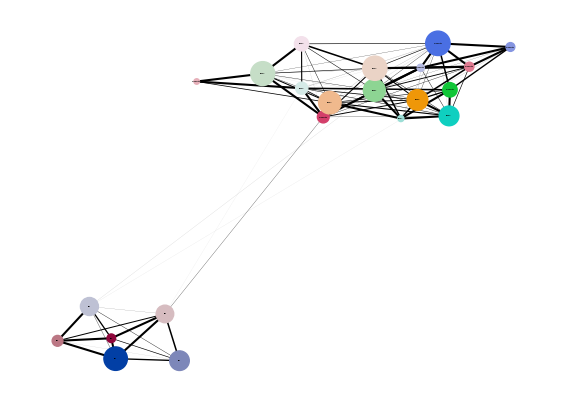

In [34]:
#sc.tl.draw_graph(adata_ctl)
sc.pl.paga(adata_ctl, 
           color=["Minor_type"],
           edge_width_scale=0.2, 
           frameon = False, 
           fontsize = 0,
           cmap = rgb_colors
)


(np.float64(-1.05),
 np.float64(22.05),
 np.float64(0.945),
 np.float64(1.0550000000000002))

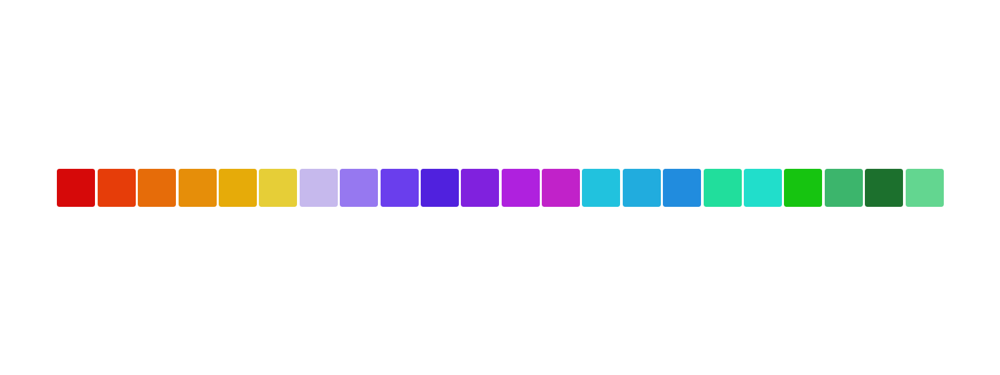

In [35]:
fig = plt.subplots(figsize =(3.6, 1.2),dpi=500)
for i in range(22):    
    plt.scatter(i,1,c=hex_colors[i],marker='s',s=50)
plt.axis('off')


In [36]:
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
#BMP_signaling = ["AHSG","BAMBI","BMP2","BMP4","BMP6","BMP7","BMPR1A","BMPR1B","BMPR2","CER1","CHRD","CHRDL1","CTDSP1","CTDSP2","CTDSPL","FST","GREM1","GSK3B","HJV","MAP3K7","MAPK1","NOG","NUP214","PPM1A","PPP1CA","PPP1R15A","RGMA","RGMB","SKI","SMAD1","SMAD4","SMAD5","SMAD6","SMAD7","SMAD9","SMURF1","SMURF2","SOSTDC1","TAB1","TAB2","XIAP","ZFYVE16"]
others  = ['NANOG','T','GATA6','POU5F1','HAND1','MKI67',
           'ETV2','CLDN5','PECAM1','SOX17','COL4A1','DCN',
           'ACTA2','PDGFRB','FOXA2','EOMES','MIXL1','COL5A1',
           'CXCR4','NR2F2','GJA4','PGF','RGS16','ADAMTS18'
          ]

for i in others:
    adata.var.highly_variable[i]=True

/tmp/ipykernel_43146/3298049258.py:10: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  adata.var.highly_variable[i]=True
/tmp/ipykernel_43146/3298049258.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a Da

In [37]:
'RGS16' in adata.var_names

True

In [38]:
adata = adata[:, adata.var.highly_variable]

In [39]:
adata

View of AnnData object with n_obs × n_vars = 19028 × 2007
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups'
    obsm: 'X_diffmap', 'X_pca'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

## prepare for iPSC adata

In [40]:
count = pd.read_csv('../arxived_project/squidward_study/raw_datasets/differentiation/log_normalised_counts.csv', index_col=0).transpose()
meta = pd.read_csv('../arxived_project/squidward_study/raw_datasets/differentiation/cell_metadata_cols.tsv', sep='\t')
adata_iPSC = anndata.AnnData(count)
adata_iPSC.obs=meta.copy()
adata_iPSC.layers["counts"] = adata_iPSC.X.copy()


In [41]:
groups = adata_iPSC.obs['day'].unique()
subsamp_adata = []
for group in ['day0']:
    group_adata = adata_iPSC[adata_iPSC.obs['day'] == group]
    subsamp_group_adata = group_adata[np.random.choice(group_adata.shape[0], 1000, replace=False), :]
   
    subsamp_adata.append(subsamp_group_adata)

subsamp_adata = sc.concat(subsamp_adata)
subsamp_adata.var_names = [i.split('_')[1] for i in subsamp_adata.var_names]

In [42]:
subsamp_adata.obs['Major_type']='iPSC'

In [18]:
#subsamp_adata.write('/hpc/mydata/siyu.he/squidward_study/raw_datasets/differentiation/sub_sampled_iPSC.h5ad')

In [43]:
#subsamp_adata = sc.read_h5ad('../arxived_project/squidward_study/raw_datasets/differentiation/sub_sampled_iPSC.h5ad')

## subsampling to normal VO first

In [44]:
adata.obs['group'].unique()

['Rad', 'Rad&Drug', 'Control']
Categories (3, object): ['Control', 'Rad', 'Rad&Drug']

In [45]:
adata_ctl = adata[adata.obs['group'] == 'Control'].copy()

In [46]:
adata_ctl

AnnData object with n_obs × n_vars = 5846 × 2007
    obs: 'group', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'umap_X', 'umap_Y', 'PhenoGraph_clusters', 'Major_type', 'Minor_type'
    var: 'mt', 'rb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'PhenoGraph_Q', 'PhenoGraph_clusters_colors', 'PhenoGraph_k', 'dendrogram_Minor_type', 'diffmap_evals', 'hvg', 'neighbors', 'pca', 'rank_genes_groups'
    obsm: 'X_diffmap', 'X_pca'
    varm: 'PCs'
    layers: 'scaled'
    obsp: 'connectivities', 'distances'

In [47]:
subsamp_adata

AnnData object with n_obs × n_vars = 1000 × 11231
    obs: 'assigned', 'auxDir', 'cell_filter', 'cell_name', 'compatible_fragment_ratio', 'day', 'donor', 'expected_format', 'experiment', 'frag_dist_length', 'gc_bias_correct', 'is_cell_control', 'is_cell_control_bulk', 'is_cell_control_control', 'library_types', 'libType', 'log10_total_counts', 'log10_total_counts_endogenous', 'log10_total_counts_ERCC', 'log10_total_counts_feature_control', 'log10_total_counts_MT', 'log10_total_features', 'log10_total_features_endogenous', 'log10_total_features_ERCC', 'log10_total_features_feature_control', 'log10_total_features_MT', 'mapping_type', 'mates1', 'mates2', 'n_alt_reads', 'n_total_reads', 'num_assigned_fragments', 'num_bias_bins', 'num_bootstraps', 'num_compatible_fragments', 'num_consistent_mappings', 'num_inconsistent_mappings', 'num_libraries', 'num_mapped', 'num_processed', 'num_targets', 'nvars_used', 'pct_counts_endogenous', 'pct_counts_ERCC', 'pct_counts_feature_control', 'pct_counts_

## combine normal VO and iPSC

In [48]:
adata_ctl_ipsc = sc.concat([adata_ctl,subsamp_adata])
adata_ctl_ipsc = adata_ctl_ipsc[adata_ctl_ipsc.obs['Major_type']!='HSC-like']

In [49]:
adata_ctl_ipsc.obs['Major_type']

AAACCCAAGACCAGCA-1_Control            EC
AAACCCACACACACTA-1_Control    Fibroblast
AAACCCACACCTGATA-1_Control            EC
AAACCCAGTGCCAAGA-1_Control    Fibroblast
AAACCCATCAACTTTC-1_Control         Mural
                                 ...    
25271_8#153                         iPSC
24475_3#231                         iPSC
25475_7#328                         iPSC
24353_6#249                         iPSC
25271_7#191                         iPSC
Name: Major_type, Length: 6838, dtype: category
Categories (4, object): ['EC', 'Fibroblast', 'Mural', 'iPSC']

In [50]:
adata_ctl_ipsc

View of AnnData object with n_obs × n_vars = 6838 × 596
    obs: 'total_counts', 'Major_type'

In [51]:
# Identify the most highly variable genes
#sc.pp.highly_variable_genes(adata_ctl_ipsc, n_top_genes=500)
#BMP_signaling = ["AHSG","BAMBI","BMP2","BMP4","BMP6","BMP7","BMPR1A","BMPR1B","BMPR2","CER1","CHRD","CHRDL1","CTDSP1","CTDSP2","CTDSPL","FST","GREM1","GSK3B","HJV","MAP3K7","MAPK1","NOG","NUP214","PPM1A","PPP1CA","PPP1R15A","RGMA","RGMB","SKI","SMAD1","SMAD4","SMAD5","SMAD6","SMAD7","SMAD9","SMURF1","SMURF2","SOSTDC1","TAB1","TAB2","XIAP","ZFYVE16"]
#others  = ['NANOG','T','GATA6']

#for i in others:
#    subsamp_adata.var.highly_variable[i]=True
#adata_ctl_ipsc = adata_ctl_ipsc[:, adata_ctl_ipsc.var.highly_variable]
adata_ctl_ipsc.obs = adata_ctl_ipsc.obs[['Major_type']]

In [52]:
adata_ctl_ipsc.obs['Major_type'].unique()

['EC', 'Fibroblast', 'Mural', 'iPSC']
Categories (4, object): ['EC', 'Fibroblast', 'Mural', 'iPSC']

In [53]:
del adata_ctl_ipsc.var
del adata_ctl_ipsc.obsm

In [54]:
adata_ctl_ipsc

AnnData object with n_obs × n_vars = 6838 × 596
    obs: 'Major_type'

In [55]:
sc.tl.pca(adata_ctl_ipsc, svd_solver='arpack')
sc.pp.neighbors(adata_ctl_ipsc, n_neighbors=30, n_pcs=50)
sc.tl.umap(adata_ctl_ipsc,min_dist=0.5)

EC
Fibroblast
Mural
iPSC


(np.float64(-9.741584014892577),
 np.float64(19.963317108154296),
 np.float64(-19.61391086578369),
 np.float64(20.368347358703613))

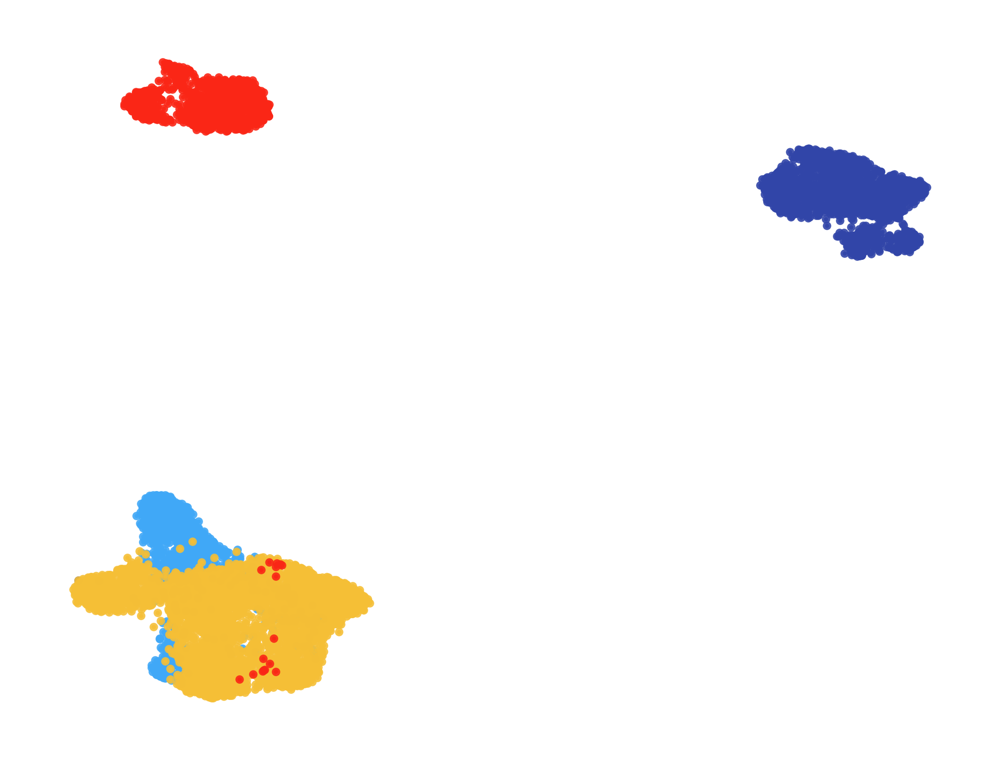

In [56]:
import matplotlib.colors as mcolors
hex_colors = ['#3145a8', '#40a8f7', '#f5bf36','#fa2616']

# Convert hexadecimal to RGB
rgb_colors = [mcolors.to_rgb(color) for color in hex_colors]

# Create a custom colormap from these colors
cmap = mcolors.LinearSegmentedColormap.from_list("custom_cmap", rgb_colors)


fig, axs = plt.subplots(1,1,figsize=(4,3),dpi=600)
for i in np.unique(adata_ctl_ipsc.obs['Major_type']):
    print(i)
    g=axs.scatter(adata_ctl_ipsc.obsm['X_umap'][adata_ctl_ipsc.obs['Major_type']==i, 0], 
                  adata_ctl_ipsc.obsm['X_umap'][adata_ctl_ipsc.obs['Major_type']==i, 1], 
                  color=rgb_colors[list(np.unique(adata_ctl_ipsc.obs['Major_type'])).index(i)], 
                  alpha=0.9,s=1, label='Reconstructed')
#plt.legend(np.unique(subsamp_adata.obs['day']))
plt.axis('off')

## if I only trained day 0 and day 11, can I predict day 1 and day 2?

In [57]:
adata_ctl_ipsc.obs['day'] = 'day11'
adata_ctl_ipsc.obs.loc[adata_ctl_ipsc.obs['Major_type']=='iPSC','day']='day0'

In [58]:
trained_adata = adata_ctl_ipsc[adata_ctl_ipsc.obs['day'].isin(['day0','day11'])].copy()

In [59]:
trained_adata.obs['Major_type'].unique()

['EC', 'Fibroblast', 'Mural', 'iPSC']
Categories (4, object): ['EC', 'Fibroblast', 'Mural', 'iPSC']

In [60]:
trained_adata.obs['day'].unique()

array(['day11', 'day0'], dtype=object)

In [61]:
trained_adata.obs['day'] = trained_adata.obs['day'].map({'day0':0,
                              'day11':1
                             })

trained_adata.obs['Major_type'] = trained_adata.obs['Major_type'].map({'EC':1,
                                                                       'Fibroblast':2,
                                                                       'Mural':3,
                                                                       'iPSC':0
                             })
trained_adata.obs['Major_type']  = trained_adata.obs['Major_type'].astype(int).astype('category')

In [77]:
trained_adata.write('/hpc/mydata/siyu.he/squidward_study/data_for_run/VO_trained_adata.h5ad')


## train model  (skip)

In [63]:
## skip this part if not training
import matplotlib
from matplotlib import rcParams
import sys
import os

import pandas as pd
import scanpy as sc
import numpy as np
import warnings

import torch
import torch.nn.functional as F
import torch.nn as nn

from torch.utils.data import DataLoader, TensorDataset

import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import anndata
import seaborn as sns
import matplotlib.font_manager
from matplotlib import rcParams

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'
rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (3,3)})
rcParams.update({'savefig.dpi': 500})
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2

import io
import os
import socket

import torch as th
import torch.distributed as dist
import argparse

from Squidiff import dist_util,logger

from Squidiff.scrna_datasets import prepared_data
from Squidiff.resample import create_named_schedule_sampler
from Squidiff.script_util import (
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    args_to_dict,
    add_dict_to_argparser,
)

from Squidiff.train_util import TrainLoop

GPUS_PER_NODE = 1  # Set this to the actual number of GPUs per node



In [64]:

def get_default_args():
    defaults = dict(
        data_dir="",
        schedule_sampler="uniform",
        lr=1e-4,
        weight_decay=0.0,
        lr_anneal_steps=0,
        batch_size=64,
        microbatch=-1,  # -1 disables microbatches
        ema_rate="0.9999",  # comma-separated list of EMA values
        log_interval=5000,
        save_interval=10000,
        resume_checkpoint="",
        use_fp16=False,
        fp16_scale_growth=1e-3,
        use_encoder=False
    )
    defaults.update(model_and_diffusion_defaults())
    return defaults



def setup_dist():
    """
    Setup a distributed process group.
    """
    if dist.is_initialized():
        return
    backend = "gloo" if not th.cuda.is_available() else "nccl"
    dist.init_process_group(backend=backend, init_method="env://")


def dev():
    """
    Get the device to use for torch.distributed.
    """
    if th.cuda.is_available():
        return th.device(f"cuda")
    return th.device("cpu")


def load_state_dict(path, **kwargs):
    """
    Load a PyTorch file without redundant fetches across ranks.
    """
    chunk_size = 2 ** 30  # Size limit for data chunks
    if dist.get_rank() == 0:
        with open(path, "rb") as f:
            data = f.read()
        num_chunks = len(data) // chunk_size
        if len(data) % chunk_size:
            num_chunks += 1
        dist.broadcast(th.tensor(num_chunks), 0)
        for i in range(0, len(data), chunk_size):
            dist.broadcast(th.tensor(data[i: i + chunk_size]), 0)
    else:
        num_chunks = dist.broadcast(th.tensor(0), 0).item()
        data = bytes()
        for _ in range(num_chunks):
            chunk = th.zeros(chunk_size, dtype=th.uint8)
            dist.broadcast(chunk, 0)
            data += bytes(chunk.numpy())

    return th.load(io.BytesIO(data), **kwargs)


def sync_params(params):
    """
    Synchronize a sequence of Tensors across ranks from rank 0.
    """
    for p in params:
        with th.no_grad():
            dist.broadcast(p, 0)


def _find_free_port():
    """
    Find a free port for distributed training setup.
    """
    try:
        s = socket.socket(socket.AF_INET, socket.SOCK_STREAM)
        s.bind(("", 0))
        s.setsockopt(socket.SOL_SOCKET, socket.SO_REUSEADDR, 1)
        return s.getsockname()[1]
    finally:
        s.close()


def run_training(args):

    logger.configure(dir='/hpc/mydata/siyu.he/squidward_study/logger_file')

    logger.log("creating model and diffusion...")
    model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )
    model.to(dev())
    schedule_sampler = create_named_schedule_sampler(args['schedule_sampler'], diffusion)

    logger.log("creating data loader...")
    data = prepared_data(
        
        data_dir=args['data_dir'],
        fn = load_VO_data
    )

    logger.log("training...")
    train_ = TrainLoop(
        model=model,
        diffusion=diffusion,
        data=data,
        batch_size=args['batch_size'],
        microbatch=args['microbatch'],
        lr=args['lr'],
        ema_rate=args['ema_rate'],
        log_interval=args['log_interval'],
        save_interval=args['save_interval'],
        resume_checkpoint=args['resume_checkpoint'],
        use_fp16=args['use_fp16'],
        fp16_scale_growth=args['fp16_scale_growth'],
        schedule_sampler=schedule_sampler,
        weight_decay=args['weight_decay'],
        lr_anneal_steps=args['lr_anneal_steps'],
    )
    train_.run_loop()
    return train_.loss_list


args = get_default_args()
args.update({
    'data_dir': '/hpc/mydata/siyu.he/Siyu_projects/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 5e5,
    'batch_size': 128,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 5000,
    'save_interval': 1e4,#1e4,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 596, 
    'output_dim':596,
    'num_layers':3,
    'class_cond': False,  
    'use_encoder': True,
})




In [ ]:
losses = run_training(args)

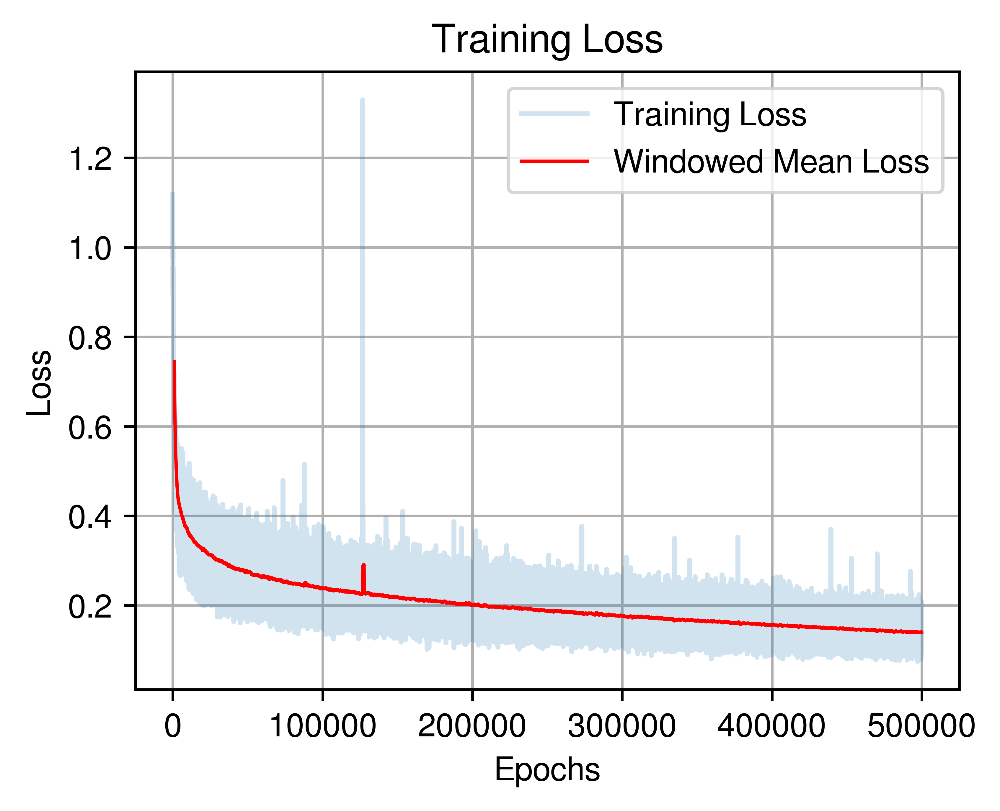

In [80]:
import matplotlib.pyplot as plt
import numpy as np

# Convert losses to a numpy array
losses_np = np.array([i.detach().cpu().numpy() for i in losses])

# Define the window size for the moving average
window_size = 1000  # You can adjust this value based on your preference

# Calculate the moving average (mean of the windowed losses)
windowed_mean_loss = np.convolve(losses_np, np.ones(window_size) / window_size, mode='valid')

# Adjust the x-axis values for the windowed mean loss
x_vals = np.linspace(0, 500000, len(losses_np))
windowed_x_vals = x_vals[window_size - 1:]  # Adjust to match the length of the windowed_mean_loss

# Plotting
plt.figure(figsize=(4.5, 3.4), dpi=800)
plt.plot(x_vals, losses_np, label='Training Loss', alpha=0.2)
plt.plot(windowed_x_vals, windowed_mean_loss, label='Windowed Mean Loss', color='r', linewidth=1)

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss')
plt.legend()
plt.grid(True)
plt.show()


## load trained model

In [72]:
import argparse
import os

import numpy as np
import torch as th
import torch.distributed as dist

from Squidiff import dist_util, logger
from Squidiff.script_util import (
    NUM_CLASSES,
    model_and_diffusion_defaults,
    create_model_and_diffusion,
    add_dict_to_argparser,
    args_to_dict,
)


def create_argparser():
    defaults = dict(
        clip_denoised=False,
        num_samples=2400,
        batch_size=16,
        use_ddim=False,
        model_path="saved_model/VO_diff_model.pt",
    )
    defaults.update(model_and_diffusion_defaults())

    return defaults


In [81]:
args = create_argparser()
args.update({
    'data_dir': '../arxived_project/squidward_study/data_for_run/',
    'schedule_sampler': 'uniform',
    'lr': 1e-4,
    'weight_decay': 0.0,
    'lr_anneal_steps': 2400,
    'batch_size': 16,
    'microbatch': -1,
    'ema_rate': '0.9999',
    'log_interval': 50,
    'save_interval': 1000,
    'resume_checkpoint': '',
    'use_fp16': False,
    'fp16_scale_growth': 1e-3,
    'gene_size': 596, 
    'output_dim':596,
    'num_layers':3,
    'class_cond': False,  
    'use_ddim':True,
    'use_encoder':True,
    
})
#dist_util.setup_dist()

logger.configure(dir='logger_file')
logger.log("creating model and diffusion...")

model, diffusion = create_model_and_diffusion(
        **args_to_dict(args, model_and_diffusion_defaults().keys())
    )

model.load_state_dict(
    dist_util.load_state_dict(args['model_path'])
)
model.to(dist_util.dev())
if args['use_fp16']:
    model.convert_to_fp16()
model.eval()


Logging to logger_file
creating model and diffusion...
diffusion num of steps =  1000


MLPModel(
  (encoder): EncoderMLPModel(
    (fc1): Linear(in_features=596, out_features=2048, bias=True)
    (bn1): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm1d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (fc2): Linear(in_features=2048, out_features=2048, bias=True)
    (fc3): Linear(in_features=2048, out_features=60, bias=True)
    (label_embed): Linear(in_features=1, out_features=2048, bias=True)
  )
  (time_embed): Sequential(
    (0): Linear(in_features=2048, out_features=2048, bias=True)
    (1): SiLU()
    (2): Linear(in_features=2048, out_features=2048, bias=True)
  )
  (mlp_blocks): TimestepEmbedSequential(
    (0): MLPBlock(
      (fc1): Linear(in_features=2048, out_features=2048, bias=True)
      (fc2): Linear(in_features=2048, out_features=2048, bias=True)
      (layer_norm1): LayerNorm((2048,), eps=1e-05, elementwise_affine=True)
      (layer_norm2): LayerNorm((2048,), eps=1e-05, eleme

In [68]:

data = sc.read_h5ad(os.path.join(args['data_dir'],'VO_trained_adata.h5ad'))


In [82]:
def stochastic_encode(
    model, x, t, model_kwargs):
    """
    ddim reverse sample
    """
    sample = x
    sample_t = []
    xstart_t = []
    T = []
    indices = list(range(t))

    for i in indices:
        timestep = torch.full((x.shape[0],), i, device='cuda').long()
        with torch.no_grad():
            out = diffusion.ddim_reverse_sample(model, 
                                                sample, 
                                                timestep, 
                                                model_kwargs=model_kwargs)
            sample = out['sample']
            sample_t.append(sample)
            xstart_t.append(out['pred_xstart'])
            T.append(timestep)

    return {
    'sample': sample,
    'sample_t': sample_t,
    'xstart_t': xstart_t,
    'T': T,
}


In [83]:
z_sem = model.encoder(torch.tensor(data[0].X.toarray()).to('cuda'),
                      #label = torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
                     )

model_kwargs = {'x_start':torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                'z_mod':z_sem,
                #'cond':torch.tensor(data[2].obs.values, dtype = torch.float32).to('cuda'),
               }

x_T = stochastic_encode(model,
                  x = torch.tensor(data[0].X.toarray(), dtype = torch.float32).to('cuda'),
                  t = 999,
                  model_kwargs=model_kwargs
                 )['sample']
label = data[0].obs.values[:,0]

In [85]:
logger.log("sampling...")
sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)


sample_interp0 = sample_fn(
                    model,
                    shape = (6838, args['gene_size']),
                    clip_denoised=args['clip_denoised'],
                    model_kwargs={
                        'z_mod': z_sem},
                    noise =  None#x_T
)

sampling...


Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.


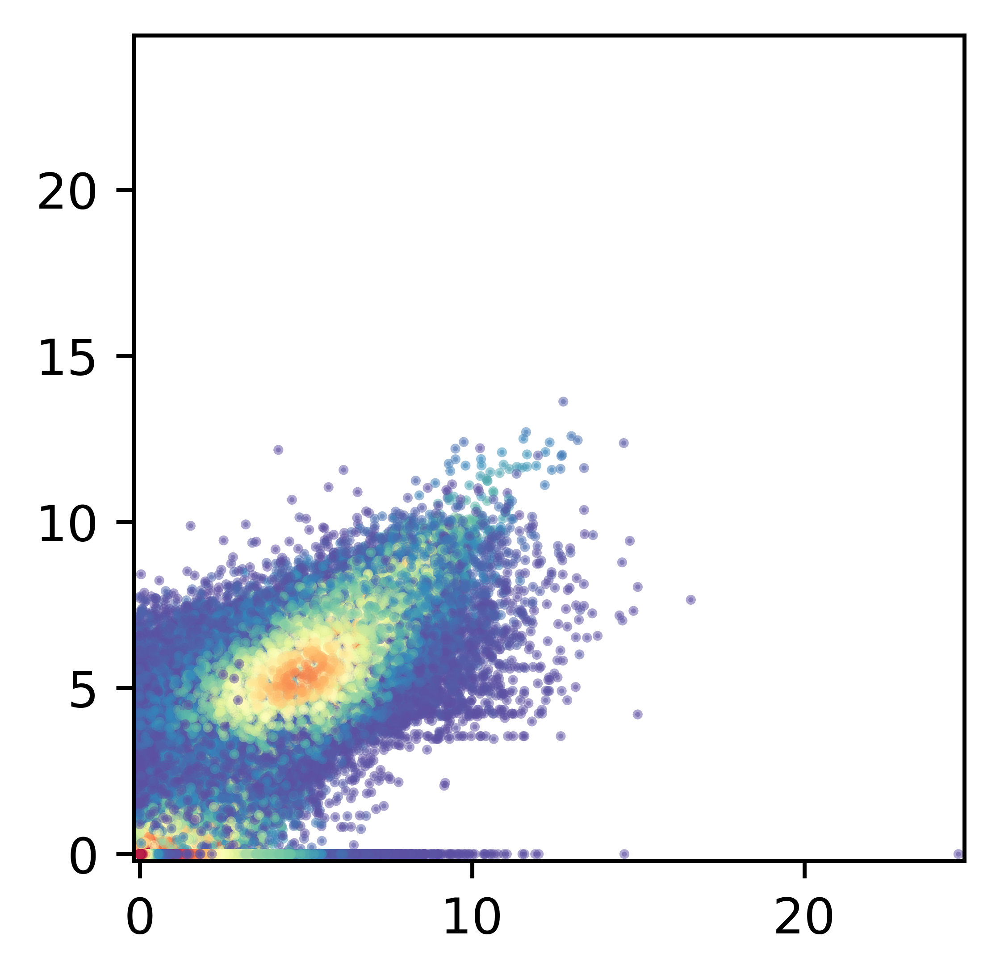

In [104]:
from scipy.stats import gaussian_kde
def display_reconst(df_true,
                    df_pred,
                    density=False,
                    den_all = False,
                    marker_genes=None,
                    sample_rate=0.1,
                    size=(4, 4),
                    spot_size=1,
                    title=None,
                    x_label='',
                    y_label='',
                    ):
    """
    Scatter plot - raw gexp vs. reconstructed gexp
    """
    assert 0 < sample_rate <= 1, \
        "Invalid downsampling rate for reconstruct scatter plot: {}".format(sample_rate)

    if marker_genes is not None:
        marker_genes = set(marker_genes)

    df_true_sample = df_true.sample(frac=sample_rate, random_state=0)
    df_pred_sample = df_pred.loc[df_true_sample.index]

    plt.rcParams["figure.figsize"] = size
    plt.figure(dpi=800)
    ax = plt.gca()

    xx = df_true_sample.T.to_numpy().flatten()
    yy = df_pred_sample.T.to_numpy().flatten()

    if density and not den_all:
        for gene in df_true_sample.columns:
            try:
                gene_true = df_true_sample[gene].values
                gene_pred = df_pred_sample[gene].values
                gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

                z = gaussian_kde(gexp_stacked)(gexp_stacked)
                ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',
                           s=spot_size, alpha=0.5)
            except np.linalg.LinAlgError as e:
                pass

    elif marker_genes is not None:
        color_dict = {True: 'red', False: 'green'}
        gene_colors = np.vectorize(
            lambda x: color_dict[x in marker_genes]
        )(df_true_sample.columns)
        colors = np.repeat(gene_colors, df_true_sample.shape[0])

        ax.scatter(xx, yy, c=colors, s=spot_size, alpha=0.5)

    elif density and den_all:
        gene_true = df_true_sample.values.flatten()
        gene_pred = df_pred_sample.values.flatten()
        gexp_stacked = np.vstack([df_true_sample.values.flatten(), df_pred_sample.values.flatten()])
        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z,vmin=0,cmap='Spectral_r',rastered=True,
                           s=spot_size, alpha=0.5)
    else:
        ax.scatter(xx, yy, s=spot_size,rastered=True,alpha=0.5)
    
    
        
    min_val = min(xx.min(), yy.min())
    max_val = max(xx.max(), yy.max())
    #ax.set_xlim(min_val, 400)
    
    #ax.set_ylim(min_val, 400)
    ax.set_aspect('equal',adjustable='box')
    ax.axis('equal')
    ax.set_xlim(0, max_val)
    ax.set_ylim(min_val-0.2, max_val)
    plt.suptitle(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)

    plt.show()
display_reconst(pd.DataFrame(sample_interp0.detach().cpu() ), 
                pd.DataFrame(data[0].X.toarray()),
                density=True,
                size=(3,3),
                #den_all=True,
               )

# SCGEN

In [16]:
import scanpy as sc
import scgen

train_adata = data[0] #torch.tensor(data[0].X.toarray()).to('cuda')
scgen.SCGEN.setup_anndata(train_adata, batch_key="day", labels_key="Major_type")
scgen_model = scgen.SCGEN(train_adata)
scgen_model.train(
    max_epochs=1000,
    batch_size=32,
    early_stopping=True,
    early_stopping_patience=50
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
You are using a CUDA device ('NVIDIA H100 80GB HBM3') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
SLURM auto-requeueing enabled. Setting signal handlers.


Epoch 52/1000:   5%|▌         | 52/1000 [00:50<15:16,  1.03it/s, v_num=1, train_loss_step=661, train_loss_epoch=643]
Monitored metric elbo_validation did not improve in the last 50 records. Best score: 2056.358. Signaling Trainer to stop.


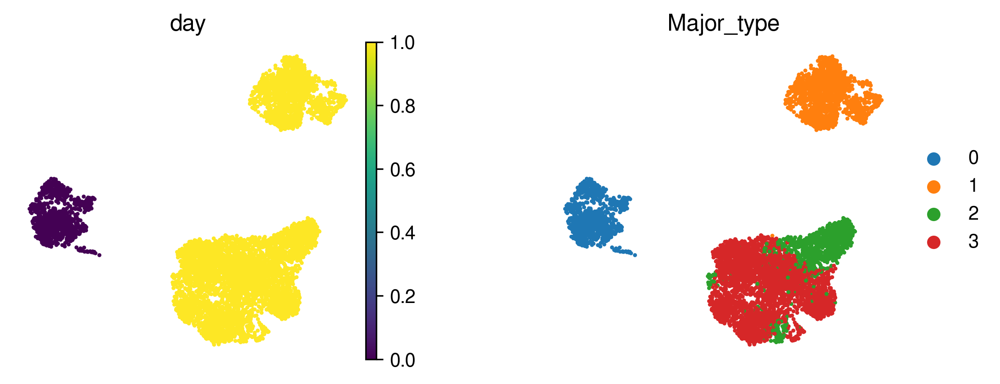

In [17]:
latent_X = scgen_model.get_latent_representation()
latent_adata = sc.AnnData(X=latent_X, obs=train_adata.obs.copy())
sc.pp.neighbors(latent_adata)
sc.tl.umap(latent_adata)
sc.pl.umap(latent_adata, color=['day', 'Major_type'], wspace=0.4, frameon=False)

         Falling back to preprocessing with `sc.pp.pca` and default params.


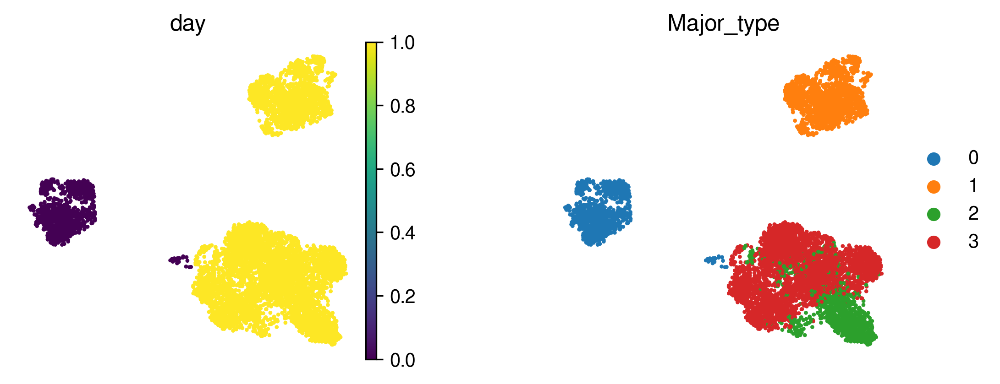

In [61]:
latent_X = scgen_model.get_latent_representation()
latent_adata = sc.AnnData(X=latent_X, obs=train_adata.obs.copy())
sc.pp.neighbors(latent_adata)
sc.tl.umap(latent_adata)
sc.pl.umap(latent_adata, color=['day', 'Major_type'], wspace=0.4, frameon=False)

In [21]:
def get_scgen_interp(label_end, label_start, num = 7):
    direct_z_sem = latent_X[label==label_end].mean(axis=0) - latent_X[label==label_start].mean(axis=0)
    
    z_sem_iPSC = scgen_model.module.inference(torch.tensor(data[0][data[0].obs['Major_type']==0].X.toarray(),dtype=torch.float32).to('cuda'))['z']

    
    interp_days = np.linspace(-1,17,num)
    interp_weights = np.linspace(0,1.5,num)
    weights_all = []
    interp_all = []
    for (i,day_) in zip(list(interp_weights), list(interp_days)):
        print(i)
        z_sem_interp_day_ = z_sem_iPSC.detach().cpu().numpy() + direct_z_sem * i

        #logger.log("sampling...")
        sample_interp_ = scgen_model.module.generative(torch.tensor(z_sem_interp_day_))['px']
    

        weights_all = weights_all + [day_]* len(z_sem_interp_day_)
        interp_all.append(sample_interp_.detach().cpu().numpy())
    interp_all = np.concatenate(interp_all)
    return weights_all, interp_all
weights_all_EC_scGEN, interp_all_EC_scGEN = get_scgen_interp(1,0, num = 10)
weights_all_fibrobalst_scGEN, interp_all_fibrobalst_scGEN = get_scgen_interp(2,0, num = 10)
weights_all_mural_scGEN, interp_all_mural_scGEN = get_scgen_interp(3,0, num = 10)

0.0
0.16666666666666666
0.3333333333333333
0.5
0.6666666666666666
0.8333333333333333
1.0
1.1666666666666665
1.3333333333333333
1.5
0.0
0.16666666666666666
0.3333333333333333
0.5
0.6666666666666666
0.8333333333333333
1.0
1.1666666666666665
1.3333333333333333
1.5
0.0
0.16666666666666666
0.3333333333333333
0.5
0.6666666666666666
0.8333333333333333
1.0
1.1666666666666665
1.3333333333333333
1.5


In [22]:
interp_all_EC_scGEN.shape

(10000, 596)

In [23]:
interp_all_scGEN = np.concatenate([interp_all_EC_scGEN,interp_all_fibrobalst_scGEN,interp_all_mural_scGEN])
weights_all_scGEN = weights_all_EC_scGEN + weights_all_fibrobalst_scGEN + weights_all_mural_scGEN
type_all_scGEN = ['EC'] * 10000 + ['Fibroblast'] * 10000 +['Mural'] * 10000 
interp_all_ann_scGEN = anndata.AnnData(interp_all_scGEN)
interp_all_ann_scGEN.var_names = data[0].var_names
interp_all_ann_scGEN.obs['label'] = weights_all_scGEN
interp_all_ann_scGEN.obs['type'] = type_all_scGEN
interp_all_ann_scGEN.obs['train'] = '-1'
interp_all_ann_scGEN.obs['train'][interp_all_ann_scGEN.obs['label'] != -1]='1'
sc.pp.pca(interp_all_ann_scGEN)
sc.pp.neighbors(interp_all_ann_scGEN)
sc.tl.umap(interp_all_ann_scGEN)
interp_all_ann_scGEN.obs['train'] =interp_all_ann_scGEN.obs['train'].astype('category')
sc.tl.embedding_density(interp_all_ann_scGEN, groupby="type")


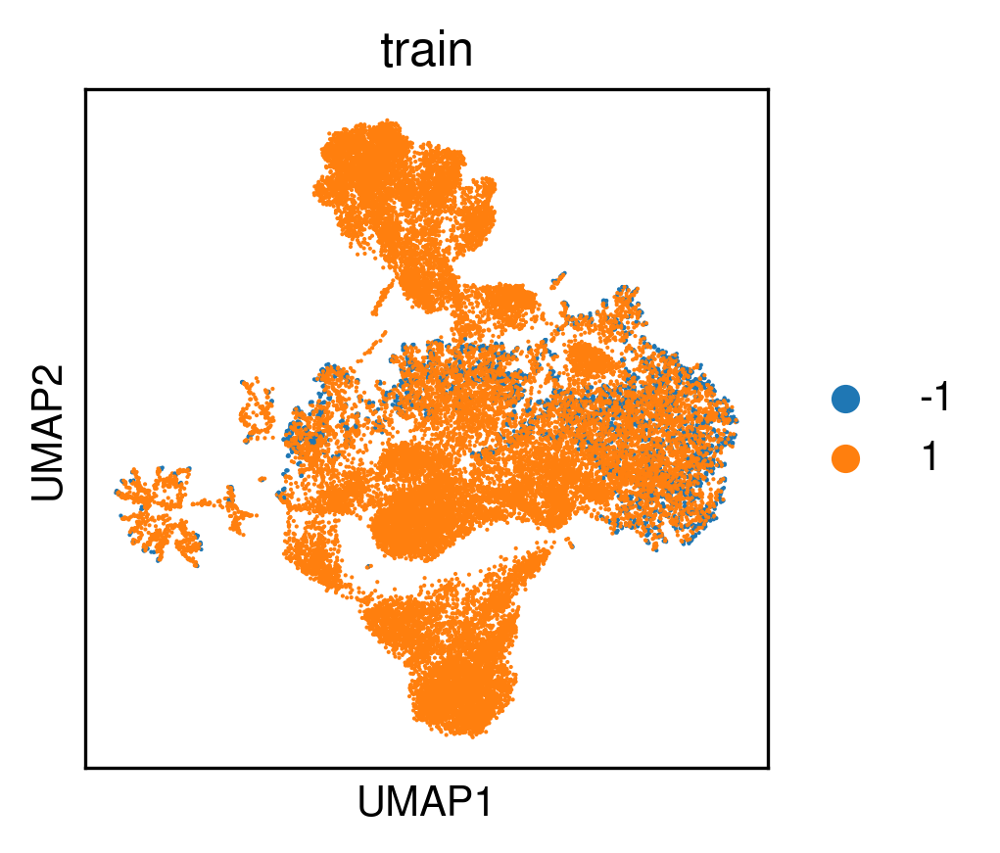

In [24]:
sc.pl.umap(interp_all_ann_scGEN,color='train')

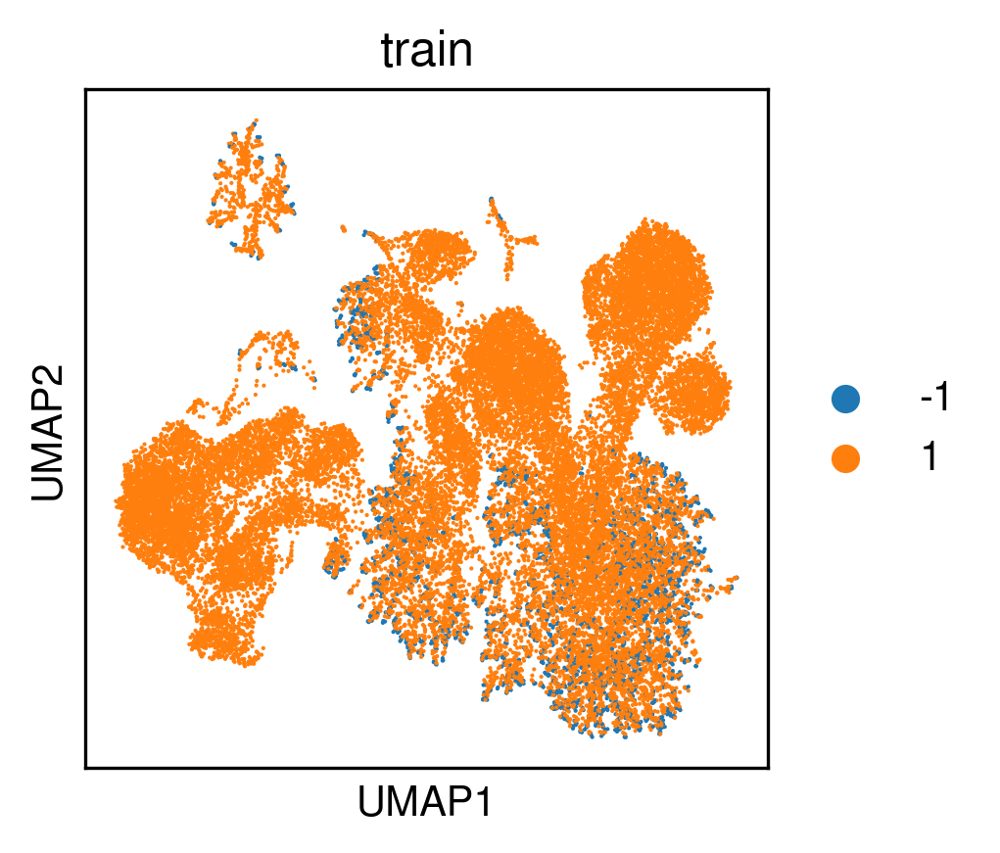

In [65]:
sc.pl.umap(interp_all_ann_scGEN,color='train')

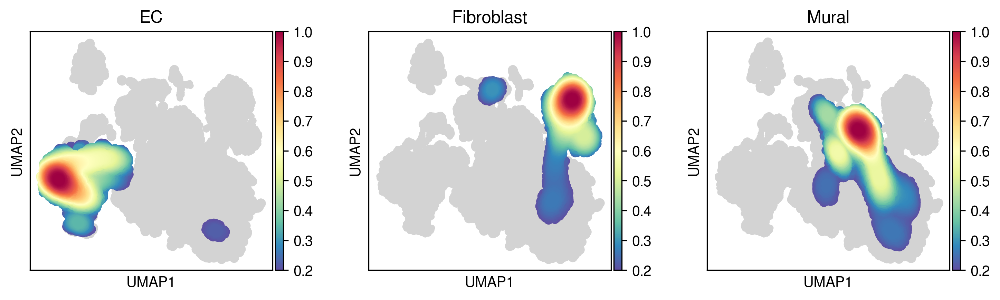

<Figure size 900x900 with 0 Axes>

In [67]:
sc.pl.embedding_density(interp_all_ann_scGEN, 
                        groupby="type", 
                        color_map='Spectral_r', 
                        vmin=0.2)

fig = plt.gcf()
for ax in fig.get_axes():
    ax.axis('off')

# Display the plot
plt.show()

# Squidiff

In [88]:
def slerp(start, direction, weight):
    """Spherical linear interpolation using a start tensor and a direction tensor"""
    end = start + direction
    
    # Correct usage of np.linalg.norm
    start_norm = start / np.linalg.norm(start, ord=2, axis=-1, keepdims=True)
    end_norm = end / np.linalg.norm(end, ord=2, axis=-1, keepdims=True)
    
    dot_product = np.sum(start_norm * end_norm, axis=-1, keepdims=True)
    omega = np.arccos(np.clip(dot_product, -1.0, 1.0))
    
    so = np.sin(omega)
    interpolated = (np.sin((1.0 - weight) * omega) / so) * start + (np.sin(weight * omega) / so) * end
    
    return interpolated
def sample_around_point(point, num_samples=1000, scale=0.2):
    return point + scale * np.random.randn(num_samples, point.shape[0])


In [89]:
def get_interp(label_end, label_start, num = 10):
    direct_z_sem = z_sem[label==label_end].mean(axis=0) - z_sem[label==label_start].mean(axis=0)
    direct_xT = x_T[label==label_end].mean(axis=0) - x_T[label==label_start].mean(axis=0)
    
    # get the iPSC "Major_type = 0"
    z_sem_iPSC = model.encoder(torch.tensor(data[0][data[0].obs['Major_type']==0].X.toarray()).to('cuda'))

    x_T_iPSC = stochastic_encode(model,
                            x = torch.tensor(data[0][data[0].obs['Major_type']==0].X.toarray(), dtype = torch.float32).to('cuda'),
                            t = 999,
                            model_kwargs={'x_start':torch.tensor(data[0][data[0].obs['Major_type']==0].X.toarray()).to('cuda'),
                                          'z_mod':z_sem_iPSC}
                           )['sample']
    interp_days = np.linspace(-1,17,num)
    interp_weights = np.linspace(0,1.5,num)
    weights_all = []
    interp_all = []
    for (i,day_) in zip(list(interp_weights), list(interp_days)):
        print(i)
        z_sem_interp_day_ = z_sem_iPSC.detach().cpu().numpy().mean(axis=0) + direct_z_sem.detach().cpu().numpy() * i
        z_sem_interp_day_ = sample_around_point(z_sem_interp_day_)
        xT_interp_day_ = slerp(x_T_iPSC.detach().cpu().numpy().mean(axis=0), direct_xT.detach().cpu().numpy(),  i)
        xT_interp_day_ = sample_around_point(xT_interp_day_)
        
        logger.log("sampling...")
        
        sample_fn = (diffusion.p_sample_loop if not args['use_ddim'] else diffusion.ddim_sample_loop)
        if day_ == -1:
            noise = x_T_iPSC
        else:
            noise = None
        #noise = None
        sample_interp_ = sample_fn(
                            model,
                            shape = (1000, args['gene_size']),
                            clip_denoised=args['clip_denoised'],
                            model_kwargs={
                                'z_mod': torch.tensor(z_sem_interp_day_, dtype = torch.float32).to('cuda') 
                            },
                            noise =  noise
        )
        weights_all = weights_all + [day_]* 1000
        interp_all.append(sample_interp_.detach().cpu().numpy())
    interp_all = np.concatenate(interp_all)
    return weights_all, interp_all

In [90]:
weights_all_EC, interp_all_EC = get_interp(1,0, num = 10)
weights_all_fibrobalst, interp_all_fibrobalst = get_interp(2,0, num = 10)
weights_all_mural, interp_all_mural = get_interp(3,0, num = 10)

0.0
sampling...
0.16666666666666666
sampling...
0.3333333333333333
sampling...
0.5
sampling...
0.6666666666666666
sampling...
0.8333333333333333
sampling...
1.0
sampling...
1.1666666666666665
sampling...
1.3333333333333333
sampling...
1.5
sampling...
0.0
sampling...
0.16666666666666666
sampling...
0.3333333333333333
sampling...
0.5
sampling...
0.6666666666666666
sampling...
0.8333333333333333
sampling...
1.0
sampling...
1.1666666666666665
sampling...
1.3333333333333333
sampling...
1.5
sampling...
0.0
sampling...
0.16666666666666666
sampling...
0.3333333333333333
sampling...
0.5
sampling...
0.6666666666666666
sampling...
0.8333333333333333
sampling...
1.0
sampling...
1.1666666666666665
sampling...
1.3333333333333333
sampling...
1.5
sampling...


In [91]:
interp_all = np.concatenate([interp_all_EC,interp_all_fibrobalst,interp_all_mural])
weights_all = weights_all_EC + weights_all_fibrobalst + weights_all_mural
type_all = ['EC'] * 10000 + ['Fibroblast'] * 10000 +['Mural'] * 10000 
interp_all_ann = anndata.AnnData(interp_all)
interp_all_ann.var_names = data[0].var_names
interp_all_ann.obs['label'] = weights_all
interp_all_ann.obs['type'] = type_all
interp_all_ann.obs['train'] = '-1'
interp_all_ann.obs['train'][interp_all_ann.obs['label'] != -1]='1'
sc.pp.pca(interp_all_ann)
sc.pp.neighbors(interp_all_ann)
sc.tl.umap(interp_all_ann)
interp_all_ann.obs['train'] =interp_all_ann.obs['train'].astype('category')

In [95]:
sc.tl.embedding_density(interp_all_ann, groupby="type")


In [20]:
#interp_all_ann.write('/hpc/mydata/siyu.he/squidward_study/results/fig4/interp_all_ann.h5ad')

In [27]:
#import scanpy as sc
#interp_all_ann = sc.read_h5ad('/hpc/mydata/siyu.he/Siyu_projects/squidward_study/results/fig4/interp_all_ann.h5ad')

findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans'

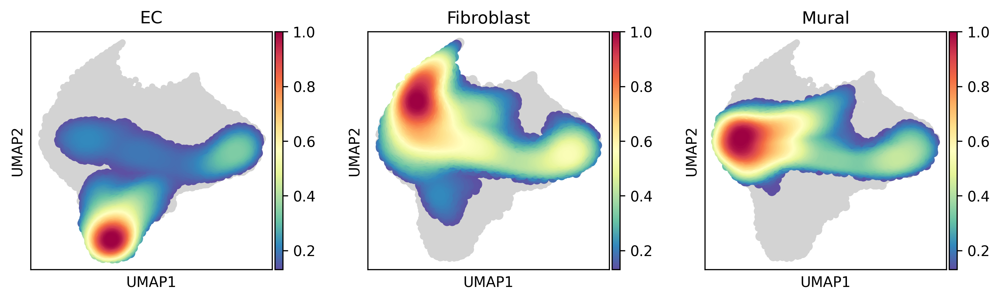

<Figure size 900x900 with 0 Axes>

In [96]:
sc.pl.embedding_density(interp_all_ann[interp_all_ann.obs['label']<20], 
                        groupby="type", 
                        color_map='Spectral_r', 
                        vmin=0.13,
                        
                       )

fig = plt.gcf()
for ax in fig.get_axes():
    ax.axis('off')

# Display the plot
plt.show()

findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans'

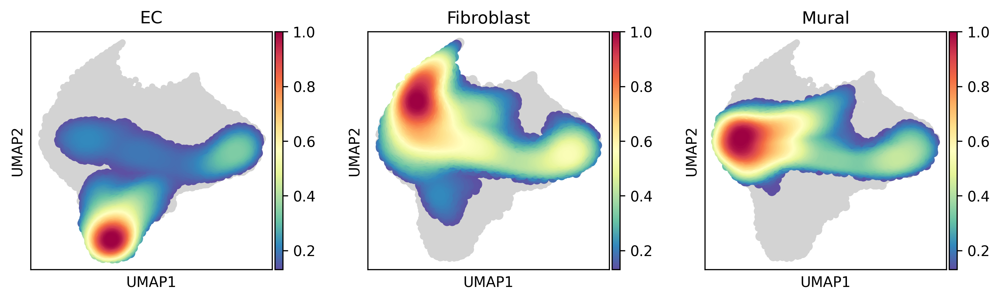

<Figure size 900x900 with 0 Axes>

In [99]:
sc.pl.embedding_density(interp_all_ann[interp_all_ann.obs['label']<25], 
                        groupby="type", 
                        color_map='Spectral_r', 
                        vmin=0.13,
                        
                       )

fig = plt.gcf()
for ax in fig.get_axes():
    ax.axis('off')

# Display the plot
plt.show()

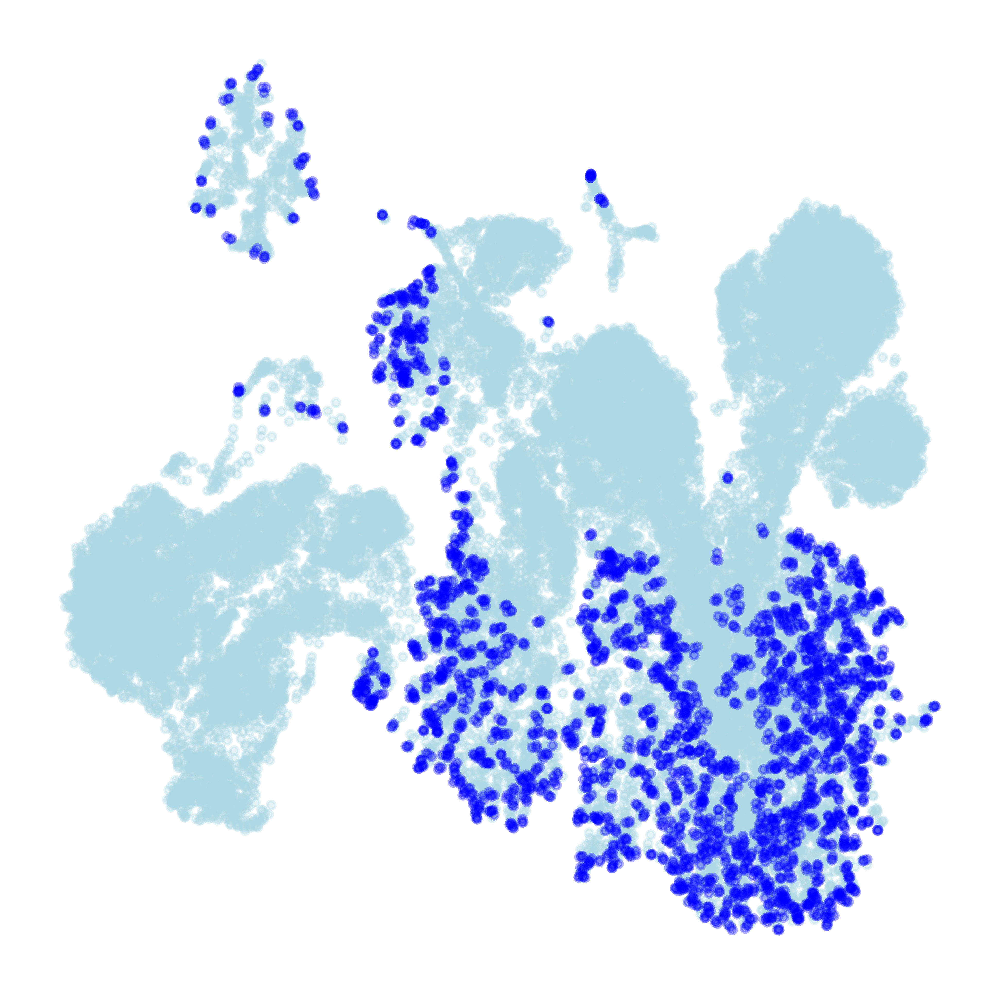

In [71]:
plt.figure(figsize=(6, 6), dpi=800)
colorlist = ['#A6A2A2','#FFEFEF','#F9D1D1','#FFA5A5','#FF7676','#E46B6B','#FF0000']  

plt.scatter(interp_all_ann_scGEN.obsm['X_umap'][(interp_all_ann_scGEN.obs['label'] != -1), 0], 
            interp_all_ann_scGEN.obsm['X_umap'][(interp_all_ann_scGEN.obs['label'] != -1), 1], 
            c='lightblue', 
            s=8, 
            alpha=0.3)
plt.scatter(interp_all_ann_scGEN.obsm['X_umap'][(interp_all_ann_scGEN.obs['label'] == -1), 0], 
            interp_all_ann_scGEN.obsm['X_umap'][(interp_all_ann_scGEN.obs['label'] == -1), 1], 
            c='blue', 
            s=8, 
            alpha=0.3)
plt.axis('off')

plt.show()

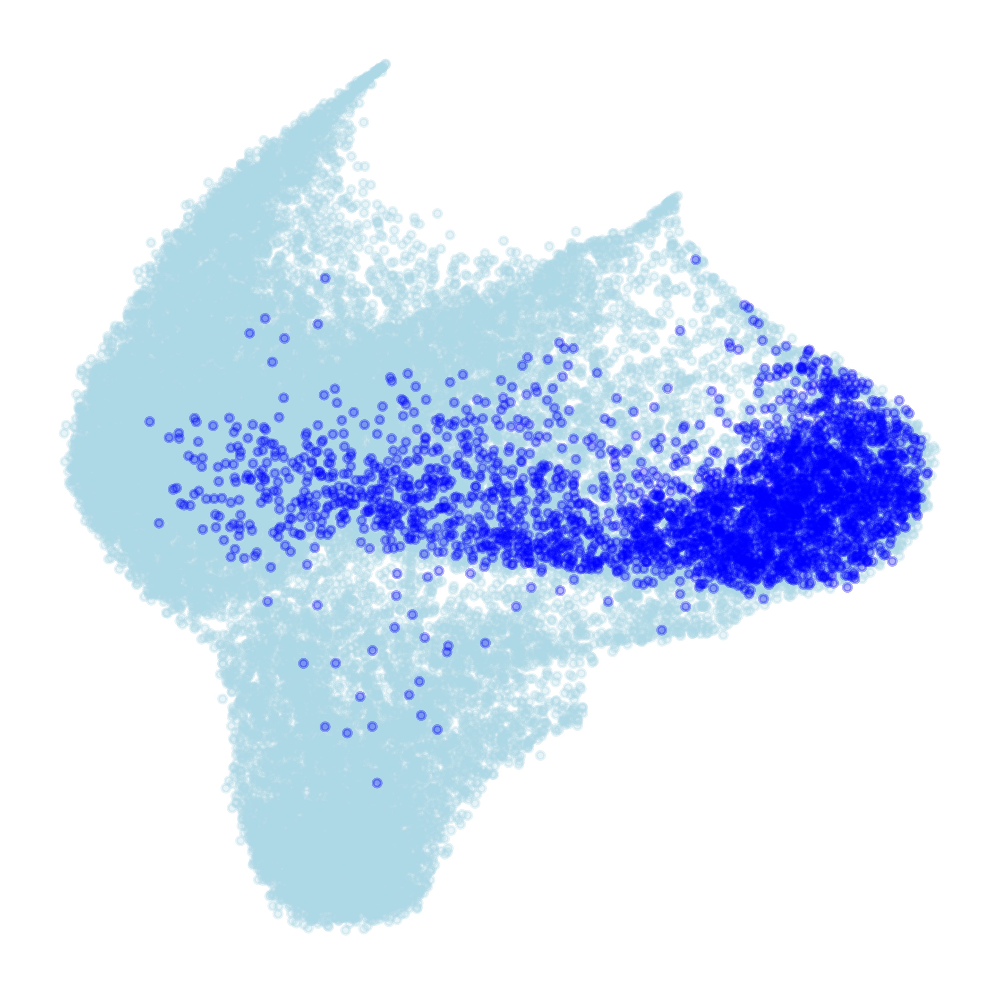

In [100]:
plt.figure(figsize=(6, 6), dpi=800)
colorlist = ['#A6A2A2','#FFEFEF','#F9D1D1','#FFA5A5','#FF7676','#E46B6B','#FF0000']  

plt.scatter(interp_all_ann.obsm['X_umap'][(interp_all_ann.obs['label'] != -1), 0], 
            interp_all_ann.obsm['X_umap'][(interp_all_ann.obs['label'] != -1), 1], 
            c='lightblue', 
            s=8, 
            alpha=0.3)
plt.scatter(interp_all_ann.obsm['X_umap'][(interp_all_ann.obs['label'] == -1), 0], 
            interp_all_ann.obsm['X_umap'][(interp_all_ann.obs['label'] == -1), 1], 
            c='blue', 
            s=8, 
            alpha=0.3)
plt.axis('off')

plt.show()

findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.
findfont: Font family 'FreeSans' not found.


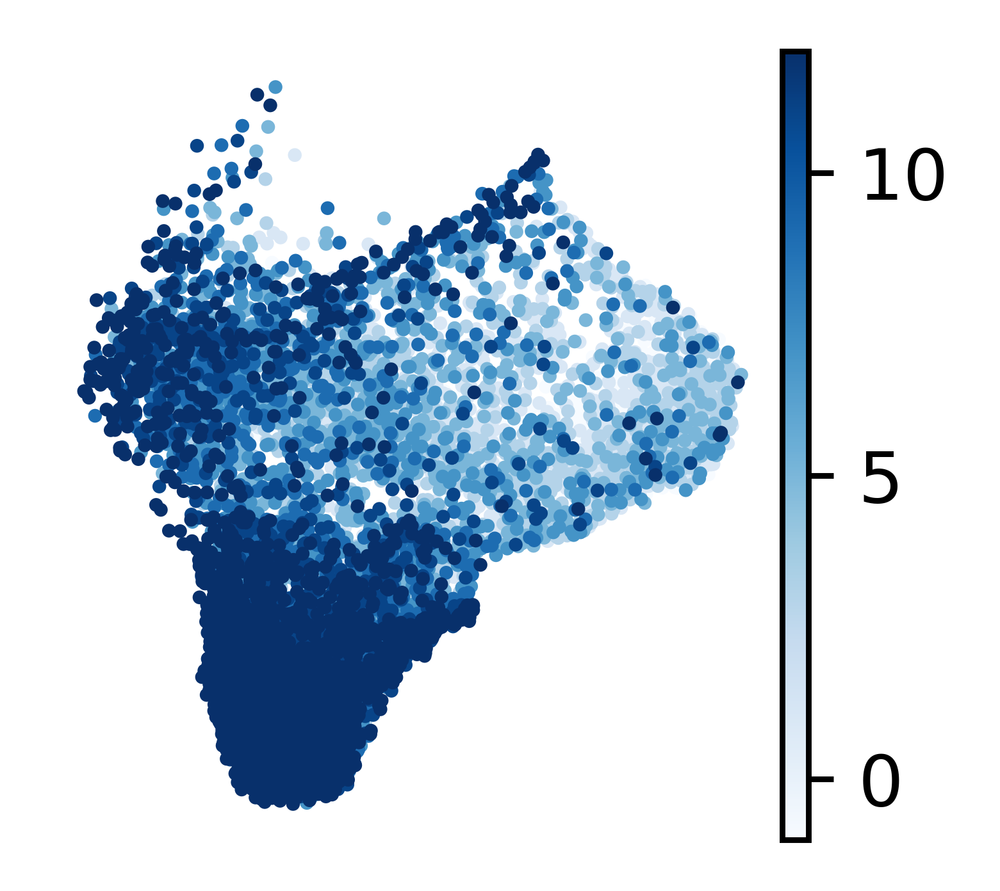

In [102]:
fig, ax = plt.subplots(1,1,figsize=(2,2),dpi=800)
sc.pl.umap(interp_all_ann[interp_all_ann.obs['type']=='EC'], color='label', 
           #vmin=1,
           vmax=12,
           ax=ax,frameon=False,
           title='',size = 15,
           cmap = 'Blues')


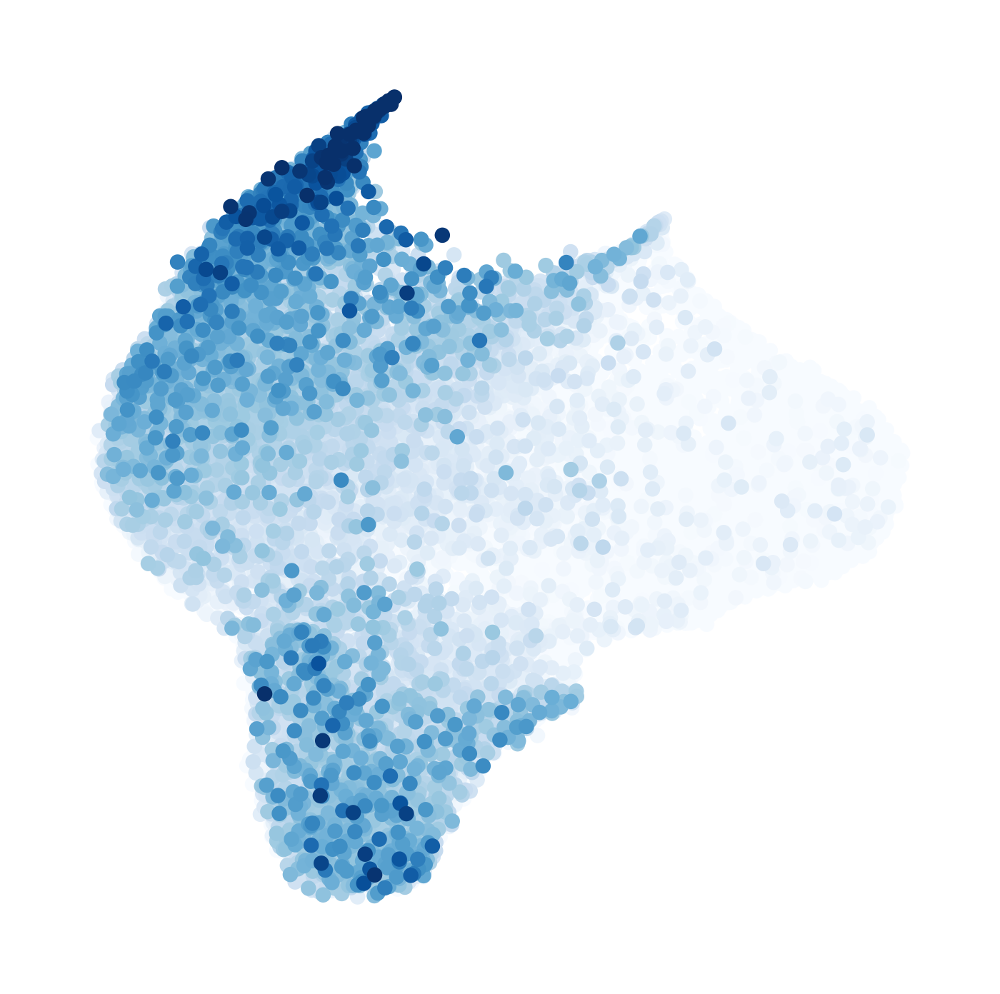

In [103]:
fig, ax = plt.subplots(1,1,figsize=(2,2),dpi=800)
sc.pl.umap(interp_all_ann, color='GATA6', vmin=1,
           vmax=10,ax=ax,frameon=False,
           colorbar_loc = None,title='',size = 15,
           cmap = 'Blues')
